## Load required packages and dataset

In [34]:
import os
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from sklearn.impute import KNNImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.cluster import KMeans
import seaborn as sns


The Global Airport Dataset, a comprehensive collection of airport information from around the world. This dataset was obtained from kaggle and can be accessed [here](https://www.kaggle.com/datasets/harshalhonde/global-aviation-hub-dataset-of-airports-worldwide/data).

In [2]:
path = '/Users/aditinagaraj/Documents/Mini_Data_Analysis/Python_EDA/data'
os.chdir(path)
data = pd.read_csv(os.path.join(path, 'airports.csv'))

In [3]:
print(data.info())
data.head(5)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 76367 entries, 0 to 76366
Data columns (total 18 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   id                 76367 non-null  int64  
 1   ident              76367 non-null  object 
 2   type               76367 non-null  object 
 3   name               76367 non-null  object 
 4   latitude_deg       76367 non-null  float64
 5   longitude_deg      76367 non-null  float64
 6   elevation_ft       61969 non-null  float64
 7   continent          39372 non-null  object 
 8   iso_country        76108 non-null  object 
 9   iso_region         76367 non-null  object 
 10  municipality       71317 non-null  object 
 11  scheduled_service  76367 non-null  object 
 12  gps_code           41345 non-null  object 
 13  iata_code          8889 non-null   object 
 14  local_code         32792 non-null  object 
 15  home_link          3694 non-null   object 
 16  wikipedia_link     110

,id,ident,type,name,latitude_deg,longitude_deg,elevation_ft,continent,iso_country,iso_region,municipality,scheduled_service,gps_code,iata_code,local_code,home_link,wikipedia_link,keywords
0,6523,00A,heliport,Total RF Heliport,40.070985,-74.933689,11.0,NaN,US,US-PA,Bensalem,no,K00A,NaN,00A,https://www.penndot.pa.gov/TravelInPA/airports...,NaN,NaN
1,323361,00AA,small_airport,Aero B Ranch Airport,38.704022,-101.473911,3435.0,NaN,US,US-KS,Leoti,no,00AA,NaN,00AA,NaN,NaN,NaN
2,6524,00AK,small_airport,Lowell Field,59.947733,-151.692524,450.0,NaN,US,US-AK,Anchor Point,no,00AK,NaN,00AK,NaN,NaN,NaN
3,6525,00AL,small_airport,Epps Airpark,34.864799,-86.770302,820.0,NaN,US,US-AL,Harvest,no,00AL,NaN,00AL,NaN,NaN,NaN
4,506791,00AN,small_airport,Katmai Lodge Airport,59.093287,-156.456699,80.0,NaN,US,US-AK,King Salmon,no,00AN,NaN,00AN,NaN,NaN,NaN


From the code chunk above we can see that there are a total of 76367 rows and 18 columns. 14 of which are categorical and 4 are numerical (1 int and 3 float) type columns. Let us now further explore our dataset to identify any data input errors, anomalies or missing values.

## Data preprocessing

From the table output above we can see that our dataset contain input processing errors. North America is missing within the continent column and has been replaced by NaN for NA during file reading. Let's correct this and check for duplicated and missing values followed by filtering of our dataset to retain only those columns that would be used in our analysis:

In [4]:
#Correct data input discrepancies
unique_values = data['continent'].unique()
print(unique_values)

data['continent'] = data['continent'].fillna('North America')
continent_mapping = {
    'EU': 'Europe',
    'AS': 'Asia',
    'AF': 'Africa',
    'OC': 'Oceania',
    'SA': 'South America',
    'AN': 'Antartica'
}

# Replace the codes with full continent names
data['continent'] = data['continent'].replace(continent_mapping)
print(data['continent'].unique())

[nan 'OC' 'AF' 'AN' 'EU' 'AS' 'SA']
['North America' 'Oceania' 'Africa' 'Antartica' 'Europe' 'Asia'
 'South America']


In [5]:
#Check for data duplication
data.duplicated().sum()

0

In [6]:
#Missing value calculation
#Calculation of number of missing records in each column
missing_num = (data.isnull().sum()/(len(data)))*100
print(f"The percent of missing records in each column is: \n {missing_num}")

The percent of missing records in each column is: 
 id                    0.000000
ident                 0.000000
type                  0.000000
name                  0.000000
latitude_deg          0.000000
longitude_deg         0.000000
elevation_ft         18.853693
continent             0.000000
iso_country           0.339152
iso_region            0.000000
municipality          6.612804
scheduled_service     0.000000
gps_code             45.860123
iata_code            88.360156
local_code           57.059987
home_link            95.162832
wikipedia_link       85.550041
keywords             77.689316
dtype: float64


We see that the data contains missing values in 9 out of the 18 columns. However, not all of these columns are required for our analysis. Let us remove the unwanted columns first and then perform imputation for the column iso_country and elevation_ft.

In [7]:
#Drop unwanted columns:
cols = ['id', 'gps_code', 'iata_code', 'local_code', 'home_link', 'wikipedia_link', 'keywords']
data.drop(cols, axis=1, inplace=True)
data.head(10)
data.tail(10)

,ident,type,name,latitude_deg,longitude_deg,elevation_ft,continent,iso_country,iso_region,municipality,scheduled_service
76357,ZYTX,large_airport,Shenyang Taoxian International Airport,41.639801,123.483002,198.0,Asia,CN,CN-21,"Hunnan, Shenyang",yes
76358,ZYXW,closed,Mt Logan Airstrip,60.792990,-138.694027,1997.0,North America,CA,CA-YT,Unorganized Yukon,no
76359,ZYYJ,medium_airport,Yanji Chaoyangchuan Airport,42.882801,129.451004,624.0,Asia,CN,CN-22,Yanji,yes
76360,ZYYK,medium_airport,Yingkou Lanqi Airport,40.542524,122.358600,NaN,Asia,CN,CN-21,"Laobian, Yingkou",yes
76361,ZYYY,medium_airport,Shenyang Dongta Airport,41.784401,123.496002,NaN,Asia,CN,CN-21,"Dadong, Shenyang",no
76362,ZZ-0001,heliport,Sealand Helipad,51.894444,1.482500,40.0,Europe,GB,GB-ENG,Sealand,no
76363,ZZ-0002,small_airport,Glorioso Islands Airstrip,-11.584278,47.296389,11.0,Africa,TF,TF-U-A,Grande Glorieuse,no
76364,ZZ-0003,small_airport,Fainting Goat Airport,32.110587,-97.356312,690.0,North America,US,US-TX,Blum,no
76365,ZZZW,closed,Scandium City Heliport,69.355287,-138.939310,4.0,North America,CA,CA-YT,(Old) Scandium City,no
76366,ZZZZ,small_airport,Satsuma Iōjima Airport,30.784722,130.270556,338.0,Asia,JP,JP-46,Mishima,no


In [8]:
#Impute missing values for iso_country column by comparing with iso_region codes:
data['country'] = data['iso_region'].str.split('-').str[0]
data['iso_country'] = data['iso_country'].fillna(data['country'])
data.drop('country', axis=1, inplace=True)

#Impute missing values for elevation_ft using KNN imputation: 
#Looks at the 'k' samples in your dataset that are closest to the missing value. 
#The missing value is then imputed using the average or median of these 'k' samples.
imputer = KNNImputer(n_neighbors=5)
data['elevation_ft'] = imputer.fit_transform(data[['elevation_ft']])


Now that we have cleaned and prepared our dataset for analysis let us perform some exploratory data analysis and plot the various trends within our dataset. 

## Exploratory Data Analysis (EDA)

We have a column called type which shows the type of airport. We see that some entries show closed. Let us first explore how many airports are still functional and how many are closed. 

In [9]:
#Create a new column called status to plot the status of an airport
def airport_status(row):
    if row['type'] == 'closed':
        return 'closed'
    else:
        return 'functional'

data['status'] = data.apply(airport_status, axis=1)

#Count closed vs functional airports
closed_count = (data['status'] == 'closed').sum()
functional_count = (data['status'] == 'functional').sum()

pie_data = {'Status': ['Closed', 'Functional'], 'Count': [closed_count, functional_count]}
df_pie = pd.DataFrame(pie_data)

#Pie chart
fig = px.pie(df_pie, names='Status', values='Count', title='Distribution of Airport Status')
fig.show()

We see that out of the 76367 airports around the world, 10798 (14.1%) have closed down and around 65K (86%) airports are still functional. Of the 65K let us now see what different types of functional airports exist.

In [10]:
functional_airports_data = data[data['status'] == 'functional']

type_counts = functional_airports_data['type'].value_counts()
fig = px.bar(type_counts, x=type_counts.index, y=type_counts.values, title='Number of Airports by Type')
fig.update_xaxes(title_text='Airport Type')
fig.update_yaxes(title_text='Count')

# Show the interactive bar plot
fig.show()


We see that small aiports are the most common types of airports. Lets see their distribution on a map and also plot their numbers in each of the continents. 

In [11]:
# Create a world map plot for small airports
small_airports_data = data[data['type'] == 'small_airport']
map_fig = px.scatter_geo(
    small_airports_data,
    lat='latitude_deg',
    lon='longitude_deg',
    scope='world',
    title='Map of Small Airports Worldwide',
    projection='natural earth',
    opacity=0.2,
    size_max=4,
)

map_fig.show()

In [12]:
continent_counts = small_airports_data['continent'].value_counts()

# Create a bar plot for the distribution of airports by continent
bar_fig = px.bar(
    continent_counts,
    x=continent_counts.index,
    y=continent_counts.values,
    title='Distribution of Small Airports by Continent',
    labels={'x': 'Continent', 'y': 'Count'},
)

bar_fig.show()

From the world map and the bar plot we see that majority of the small airports are distributed across north america. 

In [13]:
#Lets look at North America
north_america_data = small_airports_data[small_airports_data['continent'] == 'North America']
country_counts_df = north_america_data.groupby('iso_country').size().reset_index(name='counts')
country_counts_df = country_counts_df[country_counts_df['iso_country'] != 'GB']

iso2_to_iso3 = {
    'AG': 'ATG', 'AI': 'AIA', 'AW': 'ABW', 'BB': 'BRB', 'BL': 'BLM', 'BM': 'BMU', 'BQ': 'BES', 'BS': 'BHS', 'BZ': 'BLZ',
    'CA': 'CAN', 'CO': 'COL', 'CR': 'CRI', 'CU': 'CUB', 'CW': 'CUW', 'DM': 'DMA', 'DO': 'DOM', 'GD': 'GRD', 'GL': 'GRL',
    'GP': 'GLP', 'GT': 'GTM', 'HN': 'HND', 'HT': 'HTI', 'JM': 'JAM', 'KN': 'KNA', 'KY': 'CYM', 'LC': 'LCA', 'MF': 'MAF',
    'MQ': 'MTQ', 'MS': 'MSR', 'MX': 'MEX', 'NI': 'NIC', 'PA': 'PAN', 'PM': 'SPM', 'PR': 'PRI', 'SV': 'SLV', 'SX': 'SXM',
    'TC': 'TCA', 'TT': 'TTO', 'US': 'USA', 'VC': 'VCT', 'VE': 'VEN', 'VG': 'VGB', 'VI': 'VIR'
}

country_counts_df['iso3_country'] = country_counts_df['iso_country'].map(iso2_to_iso3)

fig_map = px.choropleth(country_counts_df, 
                        locations='iso3_country',
                        locationmode='ISO-3',
                        color='counts', 
                        hover_name='iso3_country', 
                        title='Number of Small Airports by Country in North America',
                        scope='north america', 
                        color_continuous_scale=px.colors.sequential.deep)

fig_map.show()


We see that the United States of America has the highest number of small airports. Lets now look at the different states in the US with small airports and the location and elevation of these airports.

In [14]:
usa_data = small_airports_data[small_airports_data['iso_country'] == 'US']
state_counts = usa_data['iso_region'].str.split('-').str[1].value_counts()

state_counts_df = state_counts.reset_index()
state_counts_df.columns = ['state', 'count']

fig_state_map = px.choropleth(state_counts_df, 
                              locationmode="USA-states",
                              locations='state',
                              color='count',
                              color_continuous_scale="RdBu",
                              scope="usa",
                              title='Number of Airports by State in the USA')
fig_state_map.show()



In [15]:
# Filter for USA airports
usa_data = small_airports_data[small_airports_data['iso_country'] == 'US']
usa_data['state'] = usa_data['iso_region'].str.split('-').str[1]

# Create a combined hover text
hover_text = usa_data['name'] + '<br>' + 'State: ' + usa_data['state']

# Create 3D scatter plot
fig_3d = go.Figure(data=[
    go.Scatter3d(
        x=usa_data['longitude_deg'],
        y=usa_data['latitude_deg'],
        z=usa_data['elevation_ft'],
        mode='markers',
        marker=dict(
            size=3,  # Setting a small marker size to manage overlapping
            color=usa_data['elevation_ft'],  # Setting color to elevation
            colorscale='Viridis',
            opacity=0.8,
            colorbar=dict(title='Elevation (ft)')
        ),
        text=hover_text,  # Using the combined hover text
        hoverinfo="text"
    )
])

# Set titles and axis labels
fig_3d.update_layout(
    title='Small Airports in USA with Elevation',
    scene=dict(
        xaxis_title='Longitude',
        yaxis_title='Latitude',
        zaxis_title='Elevation (ft)'
    )
)

# Show plot
fig_3d.show()


/var/folders/2f/gvj0ql151r33h2j4cd9m2chc0000gn/T/ipykernel_78517/3385712225.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



From the two plots above we see that Texas has the highest number of small airports. However, small airports with a high elevation of 8 to 10 thousand feet above sea level are mostly present in Utah and Colorado with Lake County Airport in Colorado located at almost 10,000 feet above sea level. 

Now that we have looked at the small airport distribution and elevation, I am curious to see the distribution and elevation of other airport types across the different continents. But before that lets generally see the distribution of airports across the different continents and across different elevations. 

In [16]:
#Distribution of airports across different continents (Only includes functional airports)
continent_counts = functional_airports_data['continent'].value_counts()

fig = px.pie(continent_counts, names=continent_counts.index, values=continent_counts.values, title='Distribution of Functional Airports by Continent')
fig.show()

Here also we see that overall North America has the highest number of airports. Lets also see if this holds true for the closed airports.

In [17]:
#Distribution of airports across different continents (for closed airports)
closed_airports_data = data[data['status'] == 'closed']
continent_counts = closed_airports_data['continent'].value_counts()

fig = px.pie(continent_counts, names=continent_counts.index, values=continent_counts.values, title='Distribution of Closed Airports by Continent')
fig.show()

In this case also we see that North America has the highest number of airports. Let us now look at the frequency distribution of airports at different elevation levels. 

In [18]:
elevation_data = data['elevation_ft'].dropna()
fig = px.histogram(elevation_data, 
                   nbins=50,  # You can adjust the number of bins as required
                   title='Frequency Distribution of Airports at Different Elevation Levels',
                   labels={'value': 'Elevation (ft)', 'count': 'Number of Airports'})

fig.show()

From this frequency distribution we see that majority of the airports (~24,000) have an elevation in the range of 0 to 500 feet above sea level. Let's now plot the distribution of elevations for different airport types (including both functional and closed). 

In [19]:
fig = px.box(data, x='type', y='elevation_ft', 
             title='Distribution of Elevations for Different Airport Types',
             labels={'type': 'Airport Type', 'elevation_ft': 'Elevation (ft)'})

fig.show()

As confirmed before, most airports have an elevation of 0 to 500 ft with some exceptions in each category. Lets go on to see if latitude or longitude influence the elevation. For instance are there higher elevations observed at certain coordinates?

In [28]:
data['elevation_ft'] = data['elevation_ft'].apply(lambda x: max(0, x))
data['color'] = data['elevation_ft'].apply(lambda x: 'above_10000' if x > 10000 else 'below_or_equal_10000')

fig = px.scatter(data, 
                 x='longitude_deg', 
                 y='latitude_deg', 
                 color='color',
                 color_discrete_map={'above_10000ft':'blue', 'below_or_equal_10000ft':'grey'},
                 size='elevation_ft', 
                 hover_name='name',
                 title='Airport Elevations based on Geographic Locations',
                 labels={'longitude_deg': 'Longitude', 'latitude_deg': 'Latitude'},
                 size_max=15)

fig.update_xaxes(title_text='Longitude')
fig.update_yaxes(title_text='Latitude')
fig.update_layout(
    coloraxis_colorbar_title='Elevation (ft)',
    plot_bgcolor='white'
)

fig.show()

From the plot we can see that most of the airports at higher elevations are located in Asia and South America. Let's now look at the types of airports with such high elevations. 

In [29]:
data['color'] = data.apply(lambda row: row['type'] if row['elevation_ft'] > 10000 else 'below_or_equal_10000', axis=1)

# Create a custom color map and add 'grey' for the 'below_or_equal_10000' value
color_map = {v: px.colors.qualitative.Set1[i] for i, v in enumerate(data['type'].unique())}
color_map['below_or_equal_10000'] = 'grey'

fig = px.scatter(data, 
                 x='longitude_deg', 
                 y='latitude_deg', 
                 color='color',
                 color_discrete_map=color_map,  # use the custom color map
                 size='elevation_ft', 
                 hover_name='name',
                 title='Airport Elevations based on Geographic Locations',
                 labels={'longitude_deg': 'Longitude', 'latitude_deg': 'Latitude'},
                 size_max=15)

fig.update_xaxes(title_text='Longitude')
fig.update_yaxes(title_text='Latitude')
fig.update_layout(
    coloraxis_colorbar_title='Elevation (ft)',
    plot_bgcolor='white')

fig.show()

From the plot we see that there is no particular type of airport that dominates. In Asia, heliports and medium airports are mainly present at higher elevations whereas in South America, small airports are present at higher elevations. 

In [31]:
#K-means clustering:
# Data transformation: one-hot encoding for categorical variables and scaling for numerical ones
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), ['elevation_ft']),
        ('cat', OneHotEncoder(), ['type', 'continent'])
    ])

data_transformed = preprocessor.fit_transform(data)

# K-means clustering
kmeans = KMeans(n_clusters=4, random_state=0).fit(data_transformed)

# Add cluster labels back to the original data
data['cluster'] = kmeans.labels_

fig = px.scatter_geo(data,
                     lat='latitude_deg',
                     lon='longitude_deg',
                     color='cluster',
                     hover_name='name',
                     title='Airport Clusters based on Type, Elevation, and Continent',
                     color_continuous_scale=px.colors.qualitative.Set1,
                     projection='natural earth')

fig.update_geos(showcoastlines=True, coastlinecolor="Black", showland=True, landcolor="white")
fig.update_layout(title_font_size=24)

fig.show()


/opt/homebrew/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



type     balloonport    closed  heliport  large_airport  medium_airport   
cluster                                                                   
0           0.000334  0.085353  0.000000       0.008063        0.081049  \
1           0.000973  0.269387  0.000000       0.004299        0.048913   
2           0.001096  0.144991  0.181307       0.004934        0.061943   
3           0.000439  0.051519  0.882703       0.006446        0.056353   

type     seaplane_base  small_airport  
cluster                                
0             0.002423       0.822777  
1             0.042302       0.634126  
2             0.001507       0.604221  
3             0.002539       0.000000  
continent    Africa  Antartica      Asia    Europe  North America   Oceania   
cluster                                                                       
0          0.103443   0.001212  0.094210  0.334559       0.000000  0.134567  \
1          0.000000   0.000000  0.000000  0.000000       1.000000  0.000

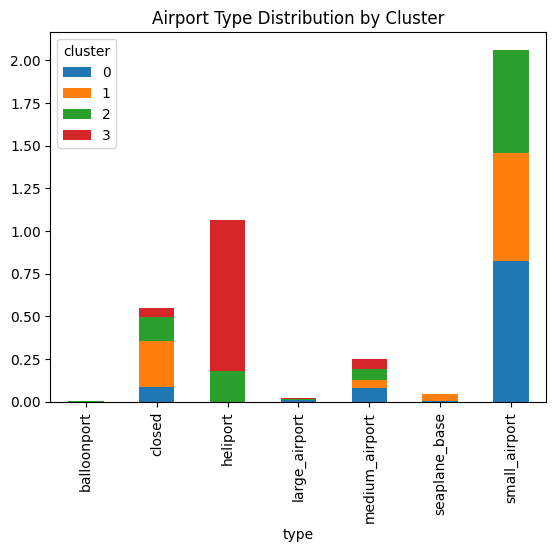

In [32]:
data['cluster'] = kmeans.labels_
grouped = data.groupby('cluster')

type_distribution = grouped['type'].value_counts(normalize=True).unstack().fillna(0)
print(type_distribution)

continent_distribution = grouped['continent'].value_counts(normalize=True).unstack().fillna(0)
print(continent_distribution)

elevation_summary = grouped['elevation_ft'].describe()
print(elevation_summary)

type_distribution.T.plot(kind='bar', stacked=True)
plt.title('Airport Type Distribution by Cluster')
plt.show()

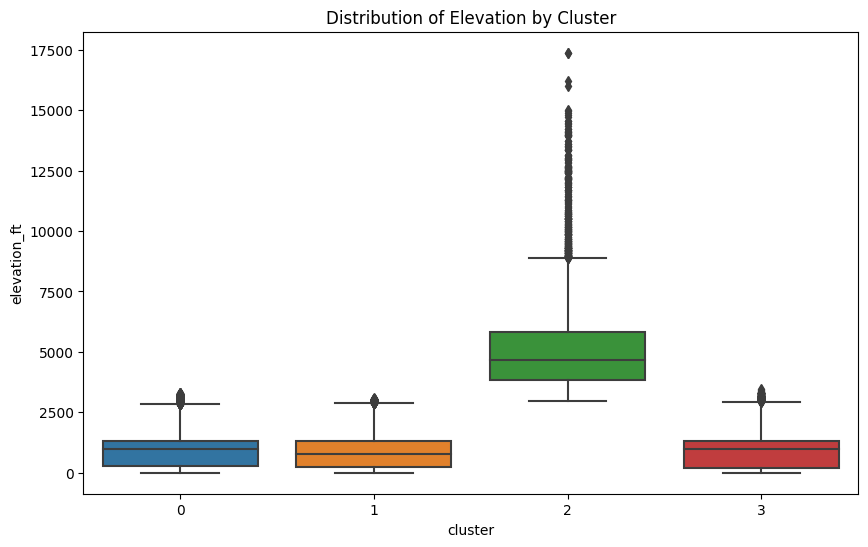

In [35]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='cluster', y='elevation_ft', data=data)
plt.title('Distribution of Elevation by Cluster')
plt.show()

Based on the plots and cluster characteristics shown above we see that-
* Cluster 0 might represent airports in Europe and South America, that are primarily small airport type and at lower elevations.

* Cluster 1 seems to be representing small airport types at low elevation mainly in North America. 

* Cluster 2 captures the high elevation airports and is dominated by heliports across different continents. 

* Cluster 3 is representing heliports at lower elevations primarily across North America and Asia. 

This is interesting and would require further analysis to understand the reson behind the different trends observed during clustering. 

## Conclusion and future steps

Having seen the distribution of airport types and elevation across continents and performed clustering, it is important to further dive into why there's a cluster of exclusively North American airports. Perhaps there's some shared characteristic among them that's unique to North America? North America also has the highest number of airports. It would also be interesting to investigate the high-elevation airports of Cluster 2. Are they mostly in mountainous regions? This might have implications for the type of aircraft that can land there or the facilities they might need etc. Finally, it is worth exploring the large presence of heliports in Cluster 3. Why do Asia and North America have more heliports? What kind of regions are these heliports located in? 